In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import random
from sklearn.model_selection import train_test_split


In [ ]:
base_dir = '/content/drive/My Drive/Train'
low_dir = os.path.join(base_dir, 'low')
high_dir = os.path.join(base_dir, 'high')

In [ ]:
low_files = [os.path.join(low_dir, file) for file in os.listdir(low_dir)]
high_files = [os.path.join(high_dir, file) for file in os.listdir(high_dir)]

In [ ]:
paired_files = []
for low_file in low_files:
    low_filename = os.path.basename(low_file)
    matching_high_file = os.path.join(high_dir, low_filename)
    if os.path.exists(matching_high_file):
        paired_files.append((low_file, matching_high_file))

In [ ]:
random.seed(42)  # For reproducibility
random.shuffle(paired_files)

In [ ]:
total_samples = len(paired_files)
print(total_samples)
train_ratio = 0.6
val_ratio = 0.2
test_ratio = 0.2


486


In [ ]:
train_samples = int(total_samples * train_ratio)
val_samples = int(total_samples * val_ratio)

In [ ]:
train_files = paired_files[:train_samples]
val_files = paired_files[train_samples:train_samples + val_samples]
test_files = paired_files[train_samples + val_samples:]


In [ ]:
train_low, train_high = zip(*train_files)
val_low, val_high = zip(*val_files)
test_low, test_high = zip(*test_files)

In [ ]:
print(f"Train low images: {len(train_low)}")
print(f"Train high images: {len(train_high)}")
print(f"Validation low images: {len(val_low)}")
print(f"Validation high images: {len(val_high)}")
print(f"Test low images: {len(test_low)}")
print(f"Test high images: {len(test_high)}")

Train low images: 291
Train high images: 291
Validation low images: 97
Validation high images: 97
Test low images: 98
Test high images: 98


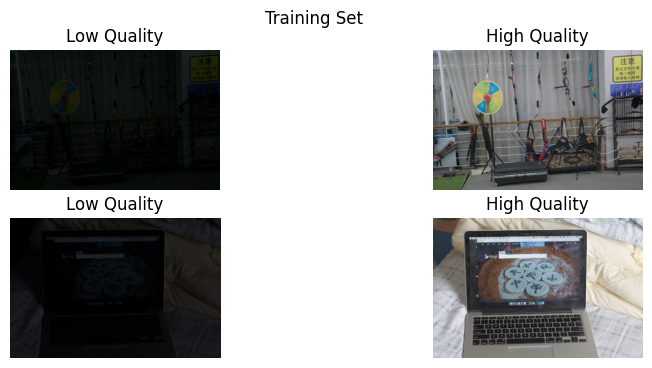

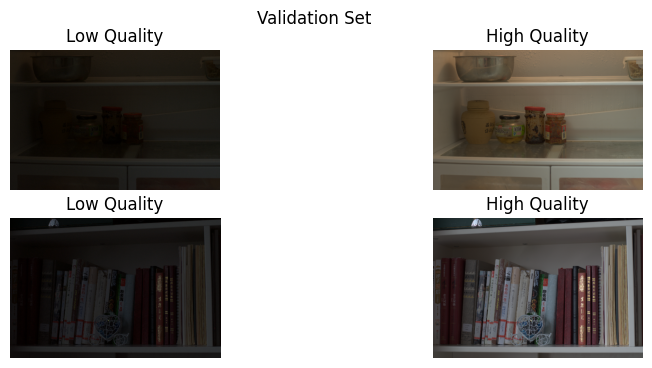

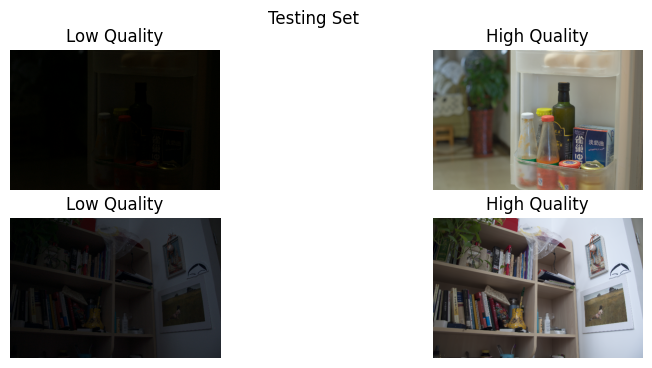

In [ ]:
import matplotlib.pyplot as plt
import cv2

# Function to display images
def display_pairs(low_images, high_images, title):
    plt.figure(figsize=(10, 4))
    for i in range(2):
        plt.subplot(2, 2, i*2 + 1)
        low_img = cv2.imread(low_images[i])
        low_img = cv2.cvtColor(low_img, cv2.COLOR_BGR2RGB)
        plt.imshow(low_img)
        plt.title('Low Quality')
        plt.axis('off')

        plt.subplot(2, 2, i*2 + 2)
        high_img = cv2.imread(high_images[i])
        high_img = cv2.cvtColor(high_img, cv2.COLOR_BGR2RGB)
        plt.imshow(high_img)
        plt.title('High Quality')
        plt.axis('off')
    plt.suptitle(title)
    plt.show()

# Display images for training set
display_pairs(train_low[:10], train_high[:10], title='Training Set')

# Display images for validation set
display_pairs(val_low[:10], val_high[:10], title='Validation Set')

# Display images for testing set
display_pairs(test_low[:10], test_high[:10], title='Testing Set')


In [ ]:
import matplotlib.pyplot as plt
import cv2

# Function to display images
def display_pairs(low_images, high_images, title):
    num_images = len(low_images)
    num_rows = (num_images + 1) // 2  # Calculate number of rows needed
    num_rows=num_images-2
    plt.figure(figsize=(15, 6 * num_rows))
    for i in range(num_images):
        plt.subplot(num_rows, 2, i*2 + 1)
        low_img = cv2.imread(low_images[i])
        low_img = cv2.cvtColor(low_img, cv2.COLOR_BGR2RGB)
        plt.imshow(low_img)
        plt.title('Low Quality')
        plt.axis('off')

        plt.subplot(num_rows, 2, i*2 + 2)
        if i < len(high_images):
            high_img = cv2.imread(high_images[i])
            high_img = cv2.cvtColor(high_img, cv2.COLOR_BGR2RGB)
            plt.imshow(high_img)
            plt.title('High Quality')
            plt.axis('off')
        else:
            # Add empty subplot if there are odd number of images
            plt.axis('off')
    plt.suptitle(title)
    plt.show()

# Display all images for training set
display_pairs(train_low, train_high, title='Training Set')

# Display all images for validation set
display_pairs(val_low, val_high, title='Validation Set')

# Display all images for testing set
display_pairs(test_low, test_high, title='Testing Set')


In [ ]:
import tensorflow as tf

# Define the MIRNet model
class ResidualBlock(tf.keras.layers.Layer):
    def __init__(self, filters, kernel_size):
        super(ResidualBlock, self).__init__()
        self.conv1 = tf.keras.layers.Conv2D(filters, kernel_size, padding='same', activation='relu')
        self.conv2 = tf.keras.layers.Conv2D(filters, kernel_size, padding='same')

    def call(self, inputs):
        x = self.conv1(inputs)
        x = self.conv2(x)
        x += inputs
        return tf.nn.relu(x)

class MIRNet(tf.keras.Model):
    def __init__(self):
        super(MIRNet, self).__init__()

        # Local Branch
        self.local_conv1 = tf.keras.layers.Conv2D(64, 3, padding='same', activation='relu')
        self.local_residual1 = ResidualBlock(64, 3)
        self.local_residual2 = ResidualBlock(64, 3)
        self.local_residual3 = ResidualBlock(64, 3)
        self.local_conv2 = tf.keras.layers.Conv2D(64, 3, padding='same')

        # Global Branch
        self.global_conv1 = tf.keras.layers.Conv2D(64, 3, strides=2, padding='same', activation='relu')
        self.global_residual1 = ResidualBlock(64, 3)
        self.global_residual2 = ResidualBlock(64, 3)
        self.global_residual3 = ResidualBlock(64, 3)
        self.global_upsampling = tf.keras.layers.UpSampling2D(size=(2, 2))

        # Fusion
        self.fusion_conv1 = tf.keras.layers.Conv2D(64, 3, padding='same', activation='relu')
        self.fusion_conv2 = tf.keras.layers.Conv2D(64, 3, padding='same', activation='relu')
        self.fusion_conv3 = tf.keras.layers.Conv2D(3, 3, padding='same', activation='sigmoid')

    def call(self, inputs):
        # Local Branch
        local_x = self.local_conv1(inputs)
        local_x = self.local_residual1(local_x)
        local_x = self.local_residual2(local_x)
        local_x = self.local_residual3(local_x)
        local_x = self.local_conv2(local_x)

        # Global Branch
        global_x = self.global_conv1(inputs)
        global_x = self.global_residual1(global_x)
        global_x = self.global_residual2(global_x)
        global_x = self.global_residual3(global_x)
        global_x = self.global_upsampling(global_x)

        # Fusion
        fusion_x = tf.concat([local_x, global_x], axis=-1)
        fusion_x = self.fusion_conv1(fusion_x)
        fusion_x = self.fusion_conv2(fusion_x)
        fusion_x = self.fusion_conv3(fusion_x)

        return fusion_x





In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# Residual Contextual Block (RCB)
class RCB(nn.Module):
    def __init__(self, in_channels, out_channels, groups=2):
        super(RCB, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, groups=groups)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1, groups=groups)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, x):
        residual = x
        out = self.relu(self.conv1(x))
        out = self.conv2(out)
        out += residual
        return out

# Selective Kernel Feature Fusion (SKFF)
class SKFF(nn.Module):
    def __init__(self, in_channels, reduction=16):
        super(SKFF, self).__init__()
        self.global_pool = nn.AdaptiveAvgPool2d(1)
        self.conv_du = nn.Sequential(
            nn.Conv2d(in_channels, in_channels // reduction, kernel_size=1, padding=0, bias=True),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels // reduction, in_channels, kernel_size=1, padding=0, bias=True),
            nn.Sigmoid()
        )

    def forward(self, x):
        batch_size, num_channels, _, _ = x.size()
        avg_out = self.global_pool(x).view(batch_size, num_channels)
        avg_out = self.conv_du(avg_out.view(batch_size, num_channels, 1, 1))
        return x * avg_out.expand_as(x)

# Multi-Scale Residual Block (MRB)
class MRB(nn.Module):
    def __init__(self, in_channels, num_streams=3):
        super(MRB, self).__init__()
        self.streams = nn.ModuleList()
        for i in range(num_streams):
            self.streams.append(RCB(in_channels, in_channels))

    def forward(self, x):
        outputs = [stream(x) for stream in self.streams]
        return sum(outputs)

# Recursive Residual Group (RRG)
class RRG(nn.Module):
    def __init__(self, in_channels, num_blocks=2):
        super(RRG, self).__init__()
        self.blocks = nn.ModuleList()
        for _ in range(num_blocks):
            self.blocks.append(MRB(in_channels))
        self.conv = nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)

    def forward(self, x):
        residual = x
        for block in self.blocks:
            x = block(x)
        x = self.conv(x)
        return x + residual

# MIRNet-v2 Model
class MIRNet_v2(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, num_rrgs=4, num_blocks=2, features=64):
        super(MIRNet_v2, self).__init__()
        self.initial_conv = nn.Conv2d(in_channels, features, kernel_size=3, padding=1)
        self.rrgs = nn.ModuleList()
        for _ in range(num_rrgs):
            self.rrgs.append(RRG(features, num_blocks))
        self.final_conv = nn.Conv2d(features, out_channels, kernel_size=3, padding=1)

    def forward(self, x):
        x = self.initial_conv(x)
        for rrg in self.rrgs:
            x = rrg(x)
        x = self.final_conv(x)
        return x

# working

In [ ]:
# train_low_images_tensor = torch.from_numpy(train_low_images).float()
# train_high_images_tensor = torch.from_numpy(train_high_images).float()
# val_low_images_tensor = torch.from_numpy(val_low_images).float()
# val_high_images_tensor = torch.from_numpy(val_high_images).float()
# test_low_images_tensor = torch.from_numpy(test_low_images_np).float()

In [ ]:
mirnet_v2_model = MIRNet_v2()

# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mirnet_v2_model.parameters(), lr=0.001)

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    mirnet_v2_model.train()
    optimizer.zero_grad()
    outputs = mirnet_v2_model(train_low_images_tensor)
    loss = criterion(outputs, train_high_images_tensor)
    loss.backward()
    optimizer.step()
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

# Validation loop
mirnet_v2_model.eval()
with torch.no_grad():
    val_outputs = mirnet_v2_model(val_low_images_tensor)
    val_loss = criterion(val_outputs, val_high_images_tensor)
    print(f'Validation Loss: {val_loss.item():.4f}')

# Predict on test data
mirnet_v2_model.eval()
with torch.no_grad():
    test_outputs = mirnet_v2_model(test_low_images_tensor)
    # Convert the outputs to numpy arrays for further processing
    test_outputs_np = test_outputs.cpu().numpy()

RuntimeError: Given groups=1, weight of size [64, 3, 3, 3], expected input[291, 256, 256, 3] to have 3 channels, but got 256 channels instead

In [ ]:
import os
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split

# Define the base directory where the data is stored
base_dir = '/content/drive/My Drive/Train'
low_dir = os.path.join(base_dir, 'low')
high_dir = os.path.join(base_dir, 'high')

# Load the file names and filter out non-image files
image_extensions = {'.jpg', '.jpeg', '.png', '.bmp', '.tiff'}

low_files = [os.path.join(low_dir, file) for file in os.listdir(low_dir) if os.path.splitext(file)[1].lower() in image_extensions]
high_files = [os.path.join(high_dir, file) for file in os.listdir(high_dir) if os.path.splitext(file)[1].lower() in image_extensions]

# Split the dataset into train, val, test
train_ratio = 0.6
val_ratio = 0.2
test_ratio = 0.2

train_low_files, valtest_low_files = train_test_split(low_files, test_size=(val_ratio + test_ratio), random_state=42)
val_low_files, test_low_files = train_test_split(valtest_low_files, test_size=test_ratio/(val_ratio + test_ratio), random_state=42)

train_high_files = [os.path.join(high_dir, os.path.basename(file)) for file in train_low_files]
val_high_files = [os.path.join(high_dir, os.path.basename(file)) for file in val_low_files]
test_high_files = [os.path.join(high_dir, os.path.basename(file)) for file in test_low_files]

def load_and_preprocess_image(file_path):
    image = Image.open(file_path).convert('RGB')  # Ensure the image is in RGB format
    image = image.resize((256, 256))  # Resize to a fixed size if needed
    image = np.array(image) / 255.0  # Normalize pixel values to [0, 1]
    return image

def load_images(image_files):
    return [load_and_preprocess_image(file) for file in image_files]

# Load and preprocess the data
train_low_images = load_images(train_low_files)
train_high_images = load_images(train_high_files)
val_low_images = load_images(val_low_files)
val_high_images = load_images(val_high_files)
test_low_images = load_images(test_low_files)
test_high_images = load_images(test_high_files)

# Convert the images to numpy arrays
train_low_images = np.array(train_low_images)
train_high_images = np.array(train_high_images)
val_low_images = np.array(val_low_images)
val_high_images = np.array(val_high_images)
test_low_images_np = np.array(test_low_images)

train_low_images_tensor = torch.from_numpy(train_low_images).float()
train_high_images_tensor = torch.from_numpy(train_high_images).float()
val_low_images_tensor = torch.from_numpy(val_low_images).float()
val_high_images_tensor = torch.from_numpy(val_high_images).float()
test_low_images_tensor = torch.from_numpy(test_low_images_np).float()

# Convert the images to numpy arrays
# train_low_images = np.array(train_low_images)
# train_high_images = np.array(train_high_images)
# val_low_images = np.array(val_low_images)
# val_high_images = np.array(val_high_images)

# Instantiate the model
# mirnet_model = MIRNet()

# # Compile the model
# mirnet_model.compile(optimizer='adam', loss='mse')

# # Train the model
# history = mirnet_model.fit(
#     train_low_images, train_high_images,
#     validation_data=(val_low_images, val_high_images),
#     epochs=100,
#     batch_size=16
# )

# Extract loss values
# train_loss = history.history['loss']
# val_loss = history.history['val_loss']
# epochs = range(1, len(train_loss) + 1)

# # Plotting loss curves
# plt.plot(epochs, train_loss, 'b', label='Training loss')
# plt.plot(epochs, val_loss, 'r', label='Validation loss')
# plt.title('Training and Validation Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

In [ ]:
train_low_images_tensor = torch.tensor(train_low_images, dtype=torch.float32).permute(0, 3, 1, 2)  # Reshape to [batch_size, channels, height, width]
train_high_images_tensor = torch.tensor(train_high_images, dtype=torch.float32).permute(0, 3, 1, 2)  # Reshape to [batch_size, channels, height, width]

mirnet_v2_model = MIRNet_v2()

# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(mirnet_v2_model.parameters(), lr=0.001)

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    mirnet_v2_model.train()
    optimizer.zero_grad()
    outputs = mirnet_v2_model(train_low_images_tensor)
    loss = criterion(outputs, train_high_images_tensor)
    loss.backward()
    optimizer.step()
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

# Validation loop
mirnet_v2_model.eval()
with torch.no_grad():
    val_outputs = mirnet_v2_model(val_low_images_tensor)
    val_loss = criterion(val_outputs, val_high_images_tensor)
    print(f'Validation Loss: {val_loss.item():.4f}')

# Predict on test data
mirnet_v2_model.eval()
with torch.no_grad():
    test_outputs = mirnet_v2_model(test_low_images_tensor)
    # Convert the outputs to numpy arrays for further processing
    test_outputs_np = test_outputs.cpu().numpy()

NameError: name 'torch' is not defined

4/4 [==============================] - 2s 448ms/step


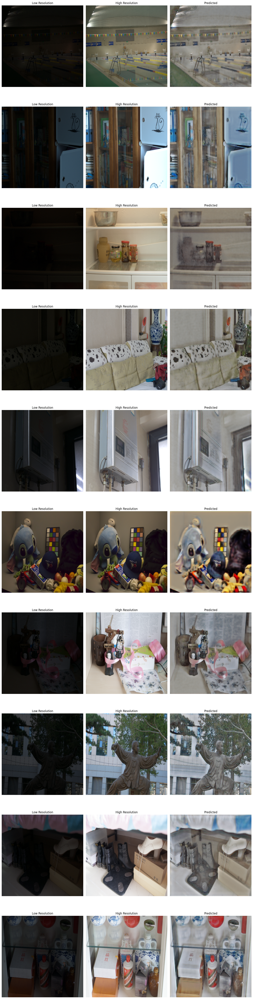

In [ ]:
import matplotlib.pyplot as plt

def plot_results(low_images, high_images, predicted_images):
    num_images = min(len(low_images), 10)
    plt.figure(figsize=(15, 6*num_images))
    for i in range(num_images):
        plt.subplot(num_images, 3, i*3 + 1)
        plt.imshow(low_images[i])
        plt.title("Low Resolution")
        plt.axis('off')

        plt.subplot(num_images, 3, i*3 + 2)
        plt.imshow(high_images[i])
        plt.title("High Resolution")
        plt.axis('off')

        plt.subplot(num_images, 3, i*3 + 3)
        plt.imshow(predicted_images[i])
        plt.title("Predicted")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Predict high-resolution images
test_low_images_np = np.array(test_low_images)
predicted_images = mirnet_model.predict(test_low_images_np)

# Plot results
plot_results(test_low_images, test_high_images, predicted_images)


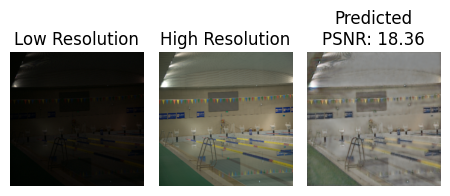

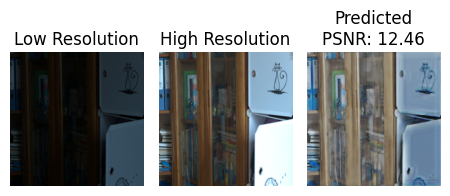

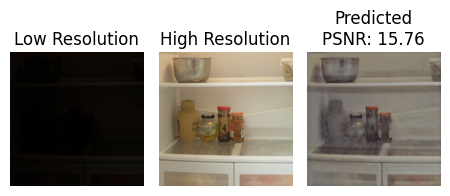

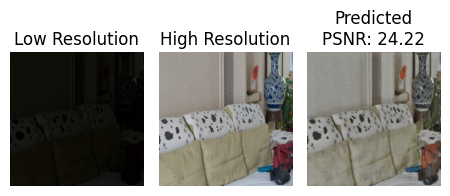

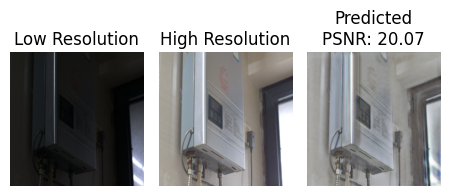

...

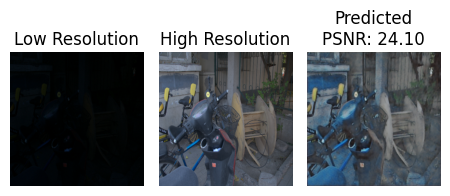

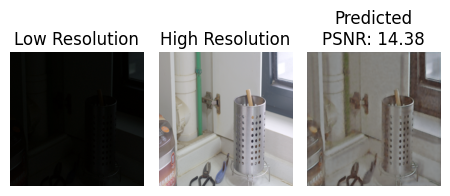

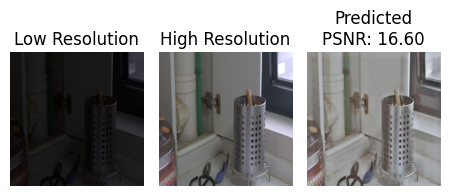

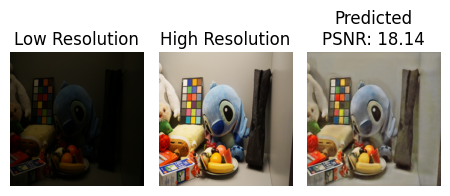

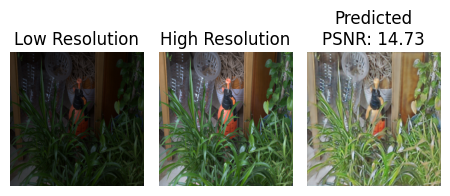

Average PSNR: 17.79


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr

def calculate_psnr(high_images, predicted_images):
    psnr_values = []
    for high_image, predicted_image in zip(high_images, predicted_images):
        psnr_value = psnr(high_image, predicted_image, data_range=1)
        psnr_values.append(psnr_value)
    return psnr_values

def plot_results(low_images, high_images, predicted_images, psnr_values):
    num_images = len(low_images)
    num_cols = 10
    num_rows = (num_images + num_cols - 1) // num_cols
    plt.figure(figsize=(15, 6*num_rows))
    for i in range(num_images):
        plt.subplot(num_rows, num_cols, i + 1)
        plt.imshow(low_images[i])
        plt.title("Low Resolution")
        plt.axis('off')

        plt.subplot(num_rows, num_cols, num_images + i + 1)
        plt.imshow(high_images[i])
        plt.title("High Resolution")
        plt.axis('off')

        plt.subplot(num_rows, num_cols, 2 * num_images + i + 1)
        plt.imshow(predicted_images[i])
        plt.title("Predicted\nPSNR: {:.2f}".format(psnr_values[i]))
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Assuming test_low_images, test_high_images, and predicted_images are defined
# Predict high-resolution images
# test_low_images_np = np.array(test_low_images)
# predicted_images = model.predict(test_low_images_np)

# Calculate PSNR values
psnr_values = calculate_psnr(test_high_images, predicted_images)
avg_psnr = np.mean(psnr_values)

# Plot results with PSNR values
# plot_results(test_low_images, test_high_images, predicted_images, psnr_values)

# Return average PSNR

# Looping over the dataset to plot images
for i in range(len(test_low_images)):
    plot_results([test_low_images[i]], [test_high_images[i]], [predicted_images[i]], [psnr_values[i]])

avg_psnr = np.mean(psnr_values)
print(f'Average PSNR: {avg_psnr:.2f}')